In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import nltk
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('punkt')
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('english'))
from nltk.tokenize import word_tokenize
import re

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
train=pd.read_csv('train.csv')
test=pd.read_csv('test.csv')

In [ ]:
train.head()

,id,keyword,location,text,target
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake M...,1
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada,1
2,5,NaN,NaN,All residents asked to 'shelter in place' are ...,1
3,6,NaN,NaN,"13,000 people receive #wildfires evacuation or...",1
4,7,NaN,NaN,Just got sent this photo from Ruby #Alaska as ...,1


# Exploratory Data Analysis

In [ ]:
train.isna().sum()

id             0
keyword       61
location    2533
text           0
target         0
dtype: int64

In [ ]:
print("Total no of unique Locations: ", len(train['location'].unique()))
print("Total no of unique keywords: ", len(train['keyword'].unique()))

Total no of unique Locations:  3342
Total no of unique keywords:  222


In [ ]:
train['Word_counts']=train['text'].apply(lambda x: len(str(x.split())))

In [ ]:
train.head()

,id,keyword,location,text,target,Word_counts
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake M...,1,109
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada,1,60
2,5,NaN,NaN,All residents asked to 'shelter in place' are ...,1,200
3,6,NaN,NaN,"13,000 people receive #wildfires evacuation or...",1,89
4,7,NaN,NaN,Just got sent this photo from Ruby #Alaska as ...,1,136


Text(0.5, 1.0, 'Target Vs. Count')

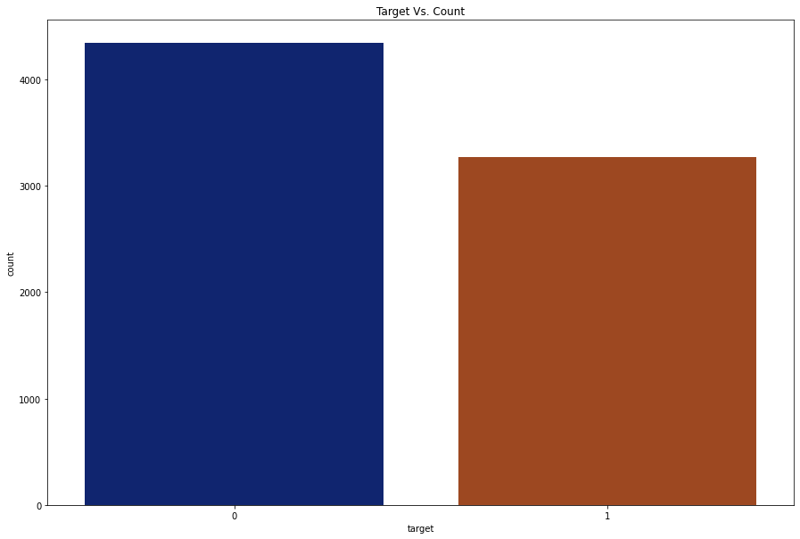

In [ ]:
plt.figure(figsize=(15,10))
sns.countplot(x="target", data=train , palette="dark")
plt.title('Target Vs. Count')

Text(0.5, 1.0, 'Piechart showing distribution of targets')

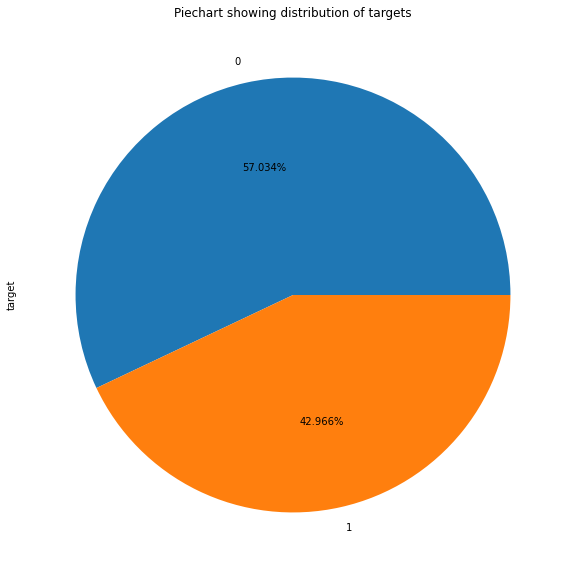

In [ ]:
piedata = train['target']
plt.figure(figsize=(15,10))
piedata.value_counts().plot(kind = 'pie',autopct = '%.3f%%')
plt.title('Piechart showing distribution of targets')

### Observations:

1. The data is balanced as we can see that percentage of tweets with label as 1 is 42.96% and with label 0 is 57.04%.

In [ ]:
from DataProcessing import get_tags
train['hashtags'] = train.text.apply(lambda text : get_tags(text, '#'))

In [ ]:
train.head()

,id,keyword,location,text,target,Word_counts,hashtags
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake M...,1,109,earthquake
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada,1,60,
2,5,NaN,NaN,All residents asked to 'shelter in place' are ...,1,200,
3,6,NaN,NaN,"13,000 people receive #wildfires evacuation or...",1,89,wildfires
4,7,NaN,NaN,Just got sent this photo from Ruby #Alaska as ...,1,136,"Alaska,wildfires"


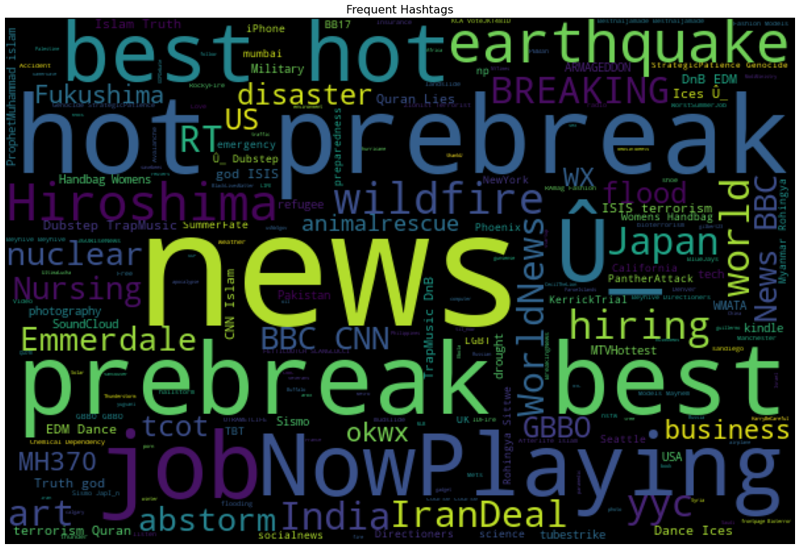

In [ ]:
from wordcloud import WordCloud
fig, (ax1) = plt.subplots(1, figsize=[20, 14])
wordcloud = WordCloud( background_color='black',width=600,height=400).generate(" ".join(train['hashtags']))
ax1.imshow(wordcloud)
ax1.axis('off')
ax1.set_title('Frequent Hashtags',fontsize=16);

**Observations**

1. The above picture represents the hashtags in the tweets.

Text(0.5, 1.0, 'Count of Location Vs. Top Keyword')

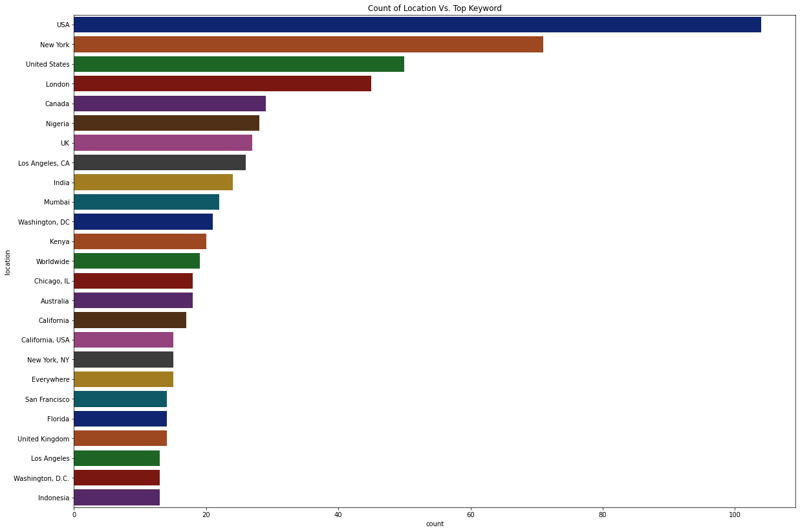

In [ ]:
plt.figure(figsize=(20,14))
sns.countplot(y = train['location'], order = train['location'].value_counts().sort_values(ascending=False).iloc[0:25].index,palette='dark')
plt.title('Count of Location Vs. Top Keyword')

### Observations:

1. The above plot shows the locations and no. of tweets generated from that location in descending order.
2. We can see the maximum number of tweets come from USA.

Text(0.5, 1.0, 'Count of keyword Vs. Top Keyword')

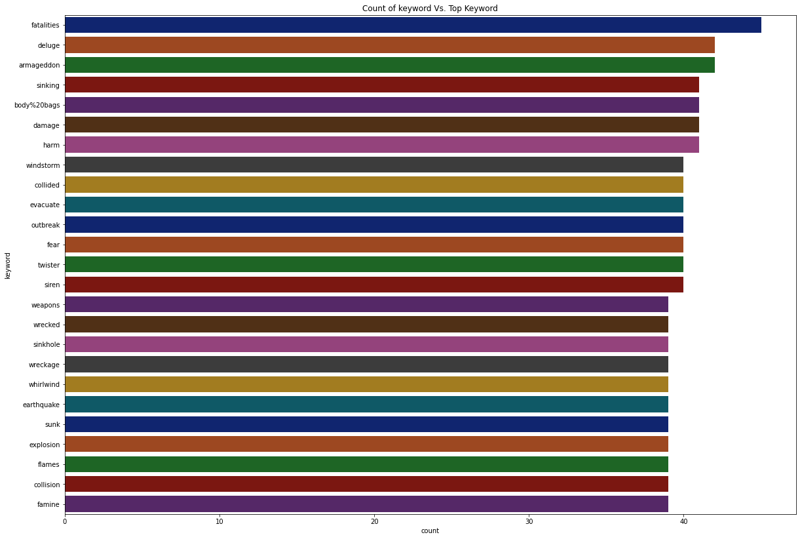

In [ ]:
plt.figure(figsize=(20,14))
sns.countplot(y = train['keyword'], order = train['keyword'].value_counts().sort_values(ascending=False).iloc[0:25].index ,palette='dark')
plt.title('Count of keyword Vs. Top Keyword')

### Observations:

1. The plot above shows the keywords which is present most frequently in tweets.
2. We can see that the most common keyword is 'fatilities'.

Text(0.5, 1.0, 'Avg no. of words in tweets Vs. TArget')

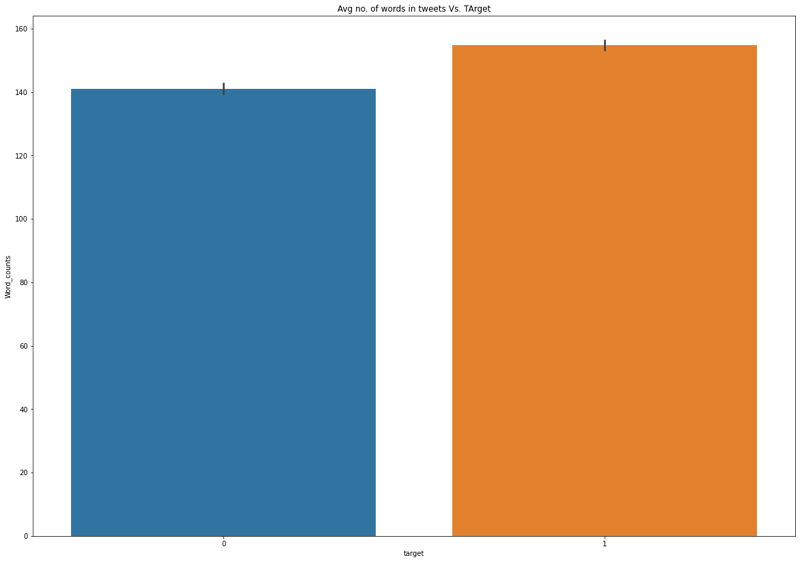

In [ ]:
plt.figure(figsize=(20,14))
sns.barplot(x='target', y='Word_counts', data=train)
plt.title('Avg no. of words in tweets Vs. TArget')

### Observations:

1. Above plot shows that the average number of words in tweets.
2. Avg no. of words in tweets belonging to class 1 is 156 and that belonging to class 0 is 140.

In [ ]:
l=[10,20,30,40,50,60,70,80,90,100]
for ele in l:
    print("{} percentile of counts is {}".format(ele,np.percentile(train['Word_counts'],ele)))

10 percentile of counts is 74.0
20 percentile of counts is 102.0
30 percentile of counts is 120.0
40 percentile of counts is 137.0
50 percentile of counts is 154.0
60 percentile of counts is 172.0
70 percentile of counts is 185.0
80 percentile of counts is 194.0
90 percentile of counts is 204.0
100 percentile of counts is 240.0


In [ ]:
l=[1,2,3,4,5,6,7,8,9,10]
for ele in l:
    print("{} percentile of counts is {}".format(ele,np.percentile(train['Word_counts'],ele)))

1 percentile of counts is 32.0
2 percentile of counts is 40.0
3 percentile of counts is 46.0
4 percentile of counts is 52.0
5 percentile of counts is 55.0
6 percentile of counts is 60.0
7 percentile of counts is 64.0
8 percentile of counts is 68.0
9 percentile of counts is 71.0
10 percentile of counts is 74.0


### Observations:

1. We can observe that there are some tweets with very less no. of words and some with very large no. of words.
2. We observe that 10 percentile value is 74 and 90 percentile value is 204.
3. Setting a threshold for word counts we can eliminate unnecessary datapoints from the dataset.

# Data Preprocessing

In [ ]:
train.drop('location',axis=1,inplace=True)

**Observations**

1. Dropping the location column from the dataframe as it contains too many missing values.

In [ ]:
train.head()

,id,keyword,text,target,Word_counts,hashtags
0,1,NaN,Our Deeds are the Reason of this #earthquake M...,1,109,earthquake
1,4,NaN,Forest fire near La Ronge Sask. Canada,1,60,
2,5,NaN,All residents asked to 'shelter in place' are ...,1,200,
3,6,NaN,"13,000 people receive #wildfires evacuation or...",1,89,wildfires
4,7,NaN,Just got sent this photo from Ruby #Alaska as ...,1,136,"Alaska,wildfires"


In [ ]:
train.keyword.fillna('NA', inplace=True)

**Observations**

1. Filling up the keyword column in the dataframe with NA where there are missing values.

In [ ]:
train.head()

,id,keyword,text,target,Word_counts,hashtags
0,1,NA,Our Deeds are the Reason of this #earthquake M...,1,109,earthquake
1,4,NA,Forest fire near La Ronge Sask. Canada,1,60,
2,5,NA,All residents asked to 'shelter in place' are ...,1,200,
3,6,NA,"13,000 people receive #wildfires evacuation or...",1,89,wildfires
4,7,NA,Just got sent this photo from Ruby #Alaska as ...,1,136,"Alaska,wildfires"


In [ ]:
train.drop('id',axis=1,inplace=True)

**Observations**

1. Dropping the id column from the dataframe as it is not at all important.

In [ ]:
train.head()

,keyword,text,target,Word_counts,hashtags
0,NA,Our Deeds are the Reason of this #earthquake M...,1,109,earthquake
1,NA,Forest fire near La Ronge Sask. Canada,1,60,
2,NA,All residents asked to 'shelter in place' are ...,1,200,
3,NA,"13,000 people receive #wildfires evacuation or...",1,89,wildfires
4,NA,Just got sent this photo from Ruby #Alaska as ...,1,136,"Alaska,wildfires"


In [ ]:
import nltk
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('punkt')
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('english'))
from nltk.tokenize import word_tokenize
import re

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
import inflect
p = inflect.engine()

In [ ]:
!pip install contractions
import contractions

     |████████████████████████████████| 284 kB 2.5 MB/s 
     |████████████████████████████████| 321 kB 18.9 MB/s 
  Created wheel for pyahocorasick: filename=pyahocorasick-1.4.2-cp37-cp37m-linux_x86_64.whl size=85449 sha256=8fcc244495d5a90378b9126a2bf519da979a967dd11a6103dde29f2148af94d5
  Stored in directory: /root/.cache/pip/wheels/25/19/a6/8f363d9939162782bb8439d886469756271abc01f76fbd790f
Successfully built pyahocorasick


In [ ]:
from nltk.stem import WordNetLemmatizer
def text_Preprocessing(text):
  
  reviews =[contractions.fix(text) for text in text]
  reviews =[text.lower() for text in reviews]
  reviews =[re.sub(r'\S+@\S+','',text) for text in reviews]
  reviews =[re.sub(r'\d+','',text) for text in reviews]
  reviews =[re.sub(r'[^\w\s]','',text) for text in reviews]
  reviews =[text.strip() for text in reviews]
    

  stop_words=set(stopwords.words('english'))
  
  cleaned_reviews=[]
  for review in reviews:
    tokens =[word for word in word_tokenize(review) if not word in stop_words]
    cleaned_reviews.append(" ".join(tokens))

  lemmatizer = WordNetLemmatizer()
  lem_reviews=[]
  for review in cleaned_reviews:
    lem_reviews.append(" ".join(list(map(lemmatizer.lemmatize , word_tokenize(review)))))
  
  return lem_reviews

In [ ]:
t=train['text']
train['text'] =text_Preprocessing(t)
train.head()

,keyword,text,target,Word_counts,hashtags
0,NA,deed reason earthquake may allah forgive u,1,109,earthquake
1,NA,forest fire near la ronge sask canada,1,60,
2,NA,resident asked shelter place notified officer ...,1,200,
3,NA,people receive wildfire evacuation order calif...,1,89,wildfires
4,NA,got sent photo ruby alaska smoke wildfire pour...,1,136,"Alaska,wildfires"


In [ ]:
f=test['text']
test['text'] =text_Preprocessing(f)
test.head()

,id,keyword,location,text
0,0,NaN,NaN,happened terrible car crash
1,2,NaN,NaN,heard earthquake different city stay safe ever...
2,3,NaN,NaN,forest fire spot pond goose fleeing across str...
3,9,NaN,NaN,apocalypse lighting spokane wildfire
4,11,NaN,NaN,typhoon soudelor kill china taiwan


In [ ]:

def remove_emoji(text):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F" 
                           u"\U0001F300-\U0001F5FF" 
                           u"\U0001F680-\U0001F6FF"  
                           u"\U0001F1E0-\U0001F1FF"  
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', text)

In [ ]:
import re
from nltk.tokenize import word_tokenize
import gensim
import string
    
train["text"] = train["text"].apply(lambda x: remove_emoji(x))
test["text"] = test["text"].apply(lambda x: remove_emoji(x))

In [ ]:
from collections import defaultdict
from wordcloud import STOPWORDS
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

DISASTER_TWEETS = train['target'] == 1
def generate_ngrams(text, n_gram=1):
    token = [token for token in text.lower().split(' ') if token != '']
    ngrams = zip(*[token[i:] for i in range(n_gram)])
    return [' '.join(ngram) for ngram in ngrams]

N = 5

# Unigrams
disaster_unigrams = defaultdict(int)
nondisaster_unigrams = defaultdict(int)

for tweet in train[train['target']==1]['text']:
    for word in generate_ngrams(tweet):
        disaster_unigrams[word] += 1
        
for tweet in train[train['target']==0]['text']:
    for word in generate_ngrams(tweet):
        nondisaster_unigrams[word] += 1
        
df_disaster_unigrams = pd.DataFrame(sorted(disaster_unigrams.items(), key=lambda x: x[1])[::-1])
df_nondisaster_unigrams = pd.DataFrame(sorted(nondisaster_unigrams.items(), key=lambda x: x[1])[::-1])

# Bigrams
disaster_bigrams = defaultdict(int)
nondisaster_bigrams = defaultdict(int)

for tweet in train[train['target']==1]['text']:
    for word in generate_ngrams(tweet, n_gram=2):
        disaster_bigrams[word] += 1
        
for tweet in train[train['target']==0]['text']:
    for word in generate_ngrams(tweet, n_gram=2):
        nondisaster_bigrams[word] += 1
        
df_disaster_bigrams = pd.DataFrame(sorted(disaster_bigrams.items(), key=lambda x: x[1])[::-1])
df_nondisaster_bigrams = pd.DataFrame(sorted(nondisaster_bigrams.items(), key=lambda x: x[1])[::-1])

# Trigrams
disaster_trigrams = defaultdict(int)
nondisaster_trigrams = defaultdict(int)

for tweet in train[train['target']==1]['text']:
    for word in generate_ngrams(tweet, n_gram=3):
        disaster_trigrams[word] += 1
        
for tweet in train[train['target']==0]['text']:
    for word in generate_ngrams(tweet, n_gram=3):
        nondisaster_trigrams[word] += 1
        
df_disaster_trigrams = pd.DataFrame(sorted(disaster_trigrams.items(), key=lambda x: x[1])[::-1])
df_nondisaster_trigrams = pd.DataFrame(sorted(nondisaster_trigrams.items(), key=lambda x: x[1])[::-1])

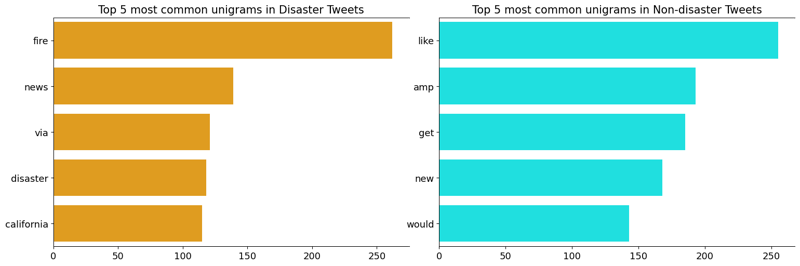

In [ ]:
fig, axes = plt.subplots(ncols=2, figsize=(15, 5), dpi=100)
plt.tight_layout()

sns.barplot(y=df_disaster_unigrams[0].values[:N], x=df_disaster_unigrams[1].values[:N], ax=axes[0], color='orange')
sns.barplot(y=df_nondisaster_unigrams[0].values[:N], x=df_nondisaster_unigrams[1].values[:N], ax=axes[1], color='cyan')

for i in range(2):
    axes[i].spines['right'].set_visible(False)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
    axes[i].tick_params(axis='x', labelsize=13)
    axes[i].tick_params(axis='y', labelsize=13)

axes[0].set_title(f'Top {N} most common unigrams in Disaster Tweets', fontsize=15)
axes[1].set_title(f'Top {N} most common unigrams in Non-disaster Tweets', fontsize=15)

plt.show()

Text(0.5, 1.0, 'Frequent unigrams for disaster tweets')

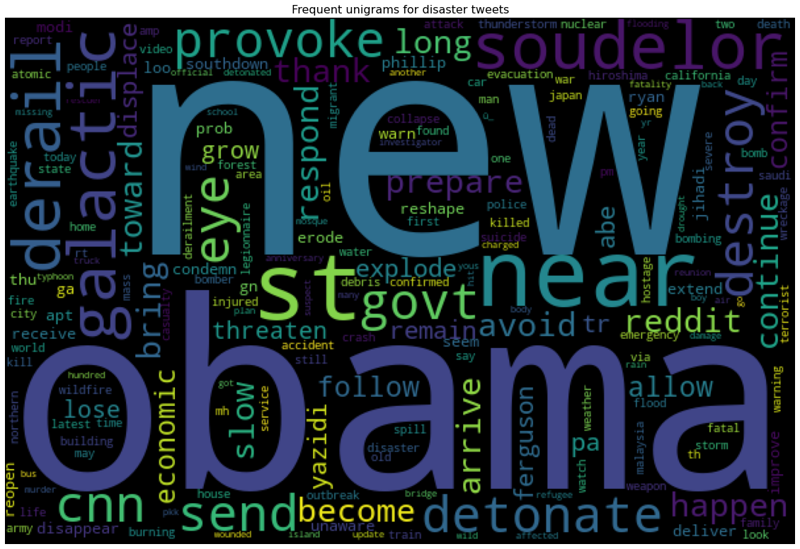

In [ ]:
fig, (ax1) = plt.subplots(1, figsize=[20, 14])
wordcloud = WordCloud( background_color='black',width=600,height=400).generate(" ".join(df_disaster_unigrams[0]))
ax1.imshow(wordcloud)
ax1.axis('off')
ax1.set_title('Frequent unigrams for disaster tweets',fontsize=16)

Text(0.5, 1.0, 'Frequent unigrams for nondisaster tweets')

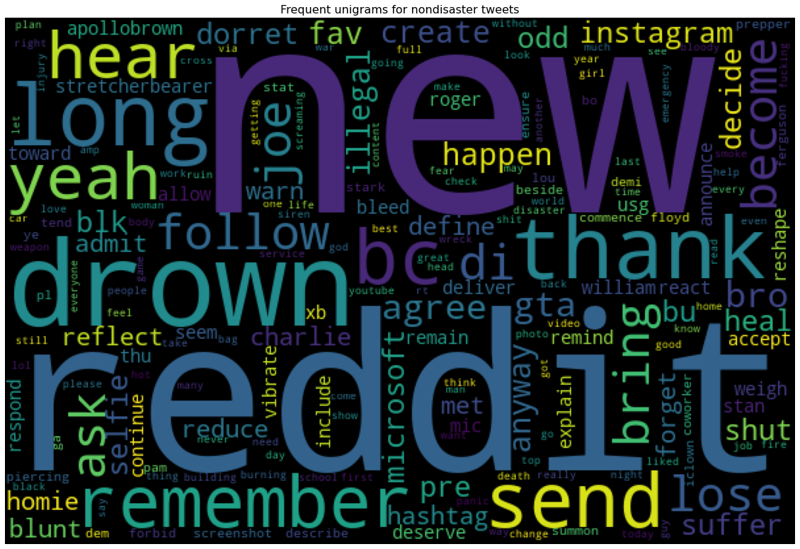

In [ ]:
fig, (ax1) = plt.subplots(1, figsize=[20, 14])
wordcloud = WordCloud( background_color='black',width=600,height=400).generate(" ".join(df_nondisaster_unigrams[0]))
ax1.imshow(wordcloud)
ax1.axis('off')
ax1.set_title('Frequent unigrams for nondisaster tweets',fontsize=16)

**Observations**

1. The above plot shows the top unigrams in Disaster and Non-Disaster tweets.
2. We can also see the Words present in both Disaster and Non-Disaster tweets by plotting the WordClouds which is plotted above.

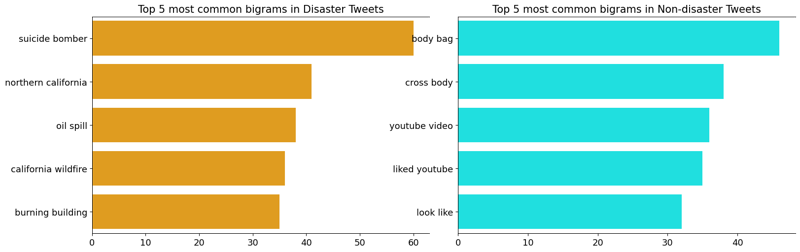

In [ ]:
fig, axes = plt.subplots(ncols=2, figsize=(15, 5), dpi=100)
plt.tight_layout()

sns.barplot(y=df_disaster_bigrams[0].values[:N], x=df_disaster_bigrams[1].values[:N], ax=axes[0], color='orange')
sns.barplot(y=df_nondisaster_bigrams[0].values[:N], x=df_nondisaster_bigrams[1].values[:N], ax=axes[1], color='cyan')

for i in range(2):
    axes[i].spines['right'].set_visible(False)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
    axes[i].tick_params(axis='x', labelsize=13)
    axes[i].tick_params(axis='y', labelsize=13)

axes[0].set_title(f'Top {N} most common bigrams in Disaster Tweets', fontsize=15)
axes[1].set_title(f'Top {N} most common bigrams in Non-disaster Tweets', fontsize=15)

plt.show()

Text(0.5, 1.0, 'Frequent Bigrams for disaster tweets')

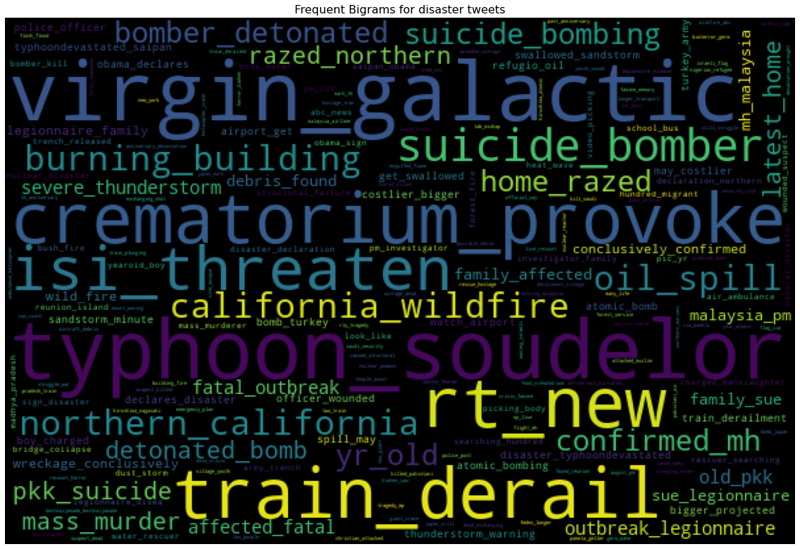

In [ ]:
bigrams=[t.replace(' ','_') for t in df_disaster_bigrams[0] ]
df_disaster_bigrams[0]=bigrams
fig, (ax1) = plt.subplots(1, figsize=[20, 14])
wordcloud = WordCloud( font_step=2, background_color='black',width=600,height=400).generate(" ".join(df_disaster_bigrams[0]))
ax1.imshow(wordcloud)
ax1.axis('off')
ax1.set_title('Frequent Bigrams for disaster tweets',fontsize=16)

Text(0.5, 1.0, 'Frequent Bigrams for nondisaster tweets')

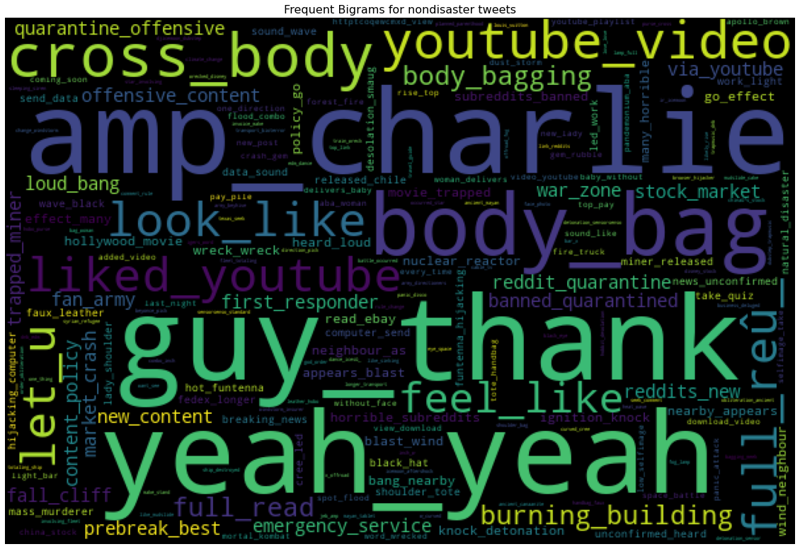

In [ ]:
bigrams=[t.replace(' ','_') for t in df_nondisaster_bigrams[0] ]
df_nondisaster_bigrams[0]=bigrams
fig, (ax1) = plt.subplots(1, figsize=[20, 14])
wordcloud = WordCloud( font_step=2, background_color='black',width=600,height=400).generate(" ".join(df_nondisaster_bigrams[0]))
ax1.imshow(wordcloud)
ax1.axis('off')
ax1.set_title('Frequent Bigrams for nondisaster tweets',fontsize=16)

**Observations**

1. The above plot shows the top bigrams in Disaster and Non-Disaster tweets.
2. We can also see the bigrams present in both Disaster and Non-Disaster tweets by plotting the WordClouds which is plotted above.

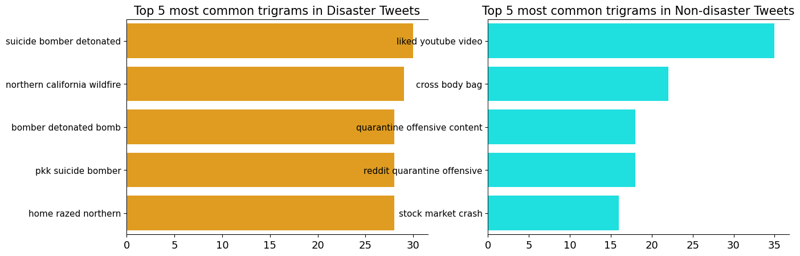

In [ ]:
fig, axes = plt.subplots(ncols=2, figsize=(15, 5), dpi=100)

sns.barplot(y=df_disaster_trigrams[0].values[:N], x=df_disaster_trigrams[1].values[:N], ax=axes[0], color='orange')
sns.barplot(y=df_nondisaster_trigrams[0].values[:N], x=df_nondisaster_trigrams[1].values[:N], ax=axes[1], color='cyan')

for i in range(2):
    axes[i].spines['right'].set_visible(False)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
    axes[i].tick_params(axis='x', labelsize=13)
    axes[i].tick_params(axis='y', labelsize=11)

axes[0].set_title(f'Top {N} most common trigrams in Disaster Tweets', fontsize=15)
axes[1].set_title(f'Top {N} most common trigrams in Non-disaster Tweets', fontsize=15)

plt.show()

Text(0.5, 1.0, 'Frequent Trigrams')

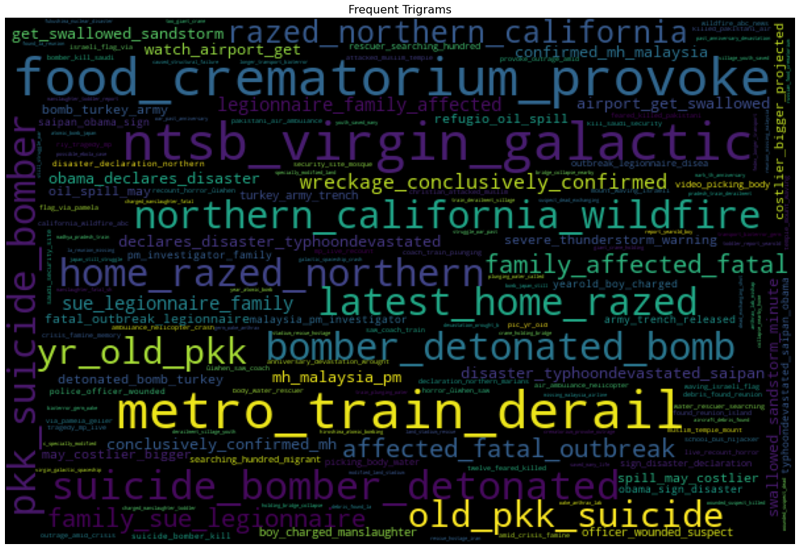

In [ ]:
trigrams=[t.replace(' ','_') for t in df_disaster_trigrams[0] ]
df_disaster_trigrams[0]=trigrams
fig, (ax1) = plt.subplots(1, figsize=[20, 14])
wordcloud = WordCloud( background_color='black',width=600,height=400).generate(" ".join(df_disaster_trigrams[0]))
ax1.imshow(wordcloud)
ax1.axis('off')
ax1.set_title('Frequent Trigrams',fontsize=16)

Text(0.5, 1.0, 'Frequent Trigrams for nondisaster tweets')

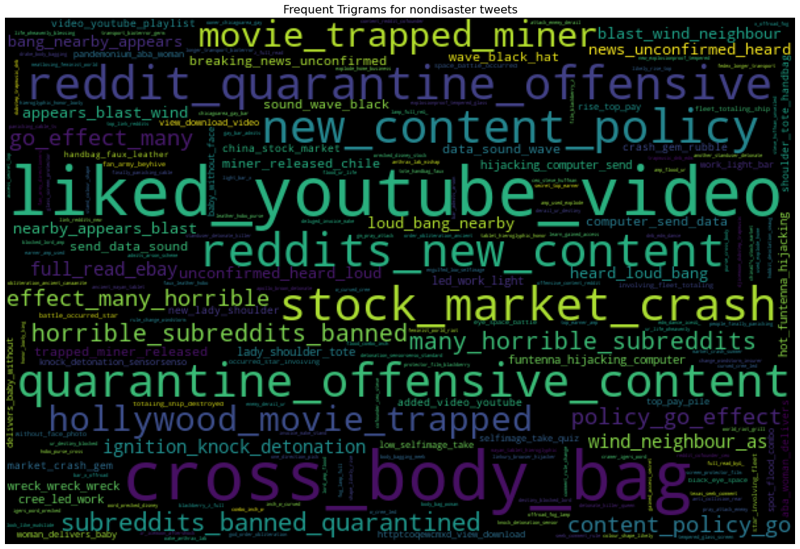

In [ ]:
trigrams=[t.replace(' ','_') for t in df_nondisaster_trigrams[0] ]
df_nondisaster_trigrams[0]=trigrams
fig, (ax1) = plt.subplots(1, figsize=[20, 14])
wordcloud = WordCloud( background_color='black',width=600,height=400).generate(" ".join(df_nondisaster_trigrams[0]))
ax1.imshow(wordcloud)
ax1.axis('off')
ax1.set_title('Frequent Trigrams for nondisaster tweets',fontsize=16)

**Observations**

1. The above plot shows the top trigrams in Disaster and Non-Disaster tweets.
2. We can also see the trigrams present in both Disaster and Non-Disaster tweets by plotting the WordClouds which is plotted above.

In [ ]:
train.head()

,keyword,text,Word_counts
0,NA,deed reason earthquake may allah forgive u,109
1,NA,forest fire near la ronge sask canada,60
2,NA,resident asked shelter place notified officer ...,200
3,NA,people receive wildfire evacuation order calif...,89
4,NA,got sent photo ruby alaska smoke wildfire pour...,136


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf = TfidfVectorizer(max_features=6000, analyzer='word', ngram_range=(1,1), stop_words='english',use_idf=True)
train = tfidf.fit_transform(train['text']).toarray()

In [ ]:
#Dataframe of Unigrams after using Tfidf
matrix1 = pd.DataFrame(train,columns=tfidf.get_feature_names())
matrix1

,__,_minimehh,aa,ab,aba,abandon,abandoned,abbott,abbswinston,abc,abcnews,abe,abia,ability,ablaze,able,abomb,abomination,abortion,absolute,absolutely,abstorm,abu_baraa,abuse,abused,abuseddesolateamplost,abusing,ac,acc,accept,access,accident,accidentally,accionempresa,according,account,accused,accuses,accustomed,acdelco,...,yycstorm,zabadani,zak_bagans,zarry,zayn,zaynmalik,zero,zimbabwe,zionism,zionist,zippednews,zipper,zombie,zone,zouma,å_,åbn,åç,åè,åê,ìñ,û_,ûextremely,ûgood,ûitûªs,ûplot,ûpolitics,ûª,ûåêdemolition,ûïa,ûïhannaphû,ûïhatchet,ûïrichmond,ûïstretcher,ûïthe,ûïwe,ûïwhen,ûïyou,ûò,ûó
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7608,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7609,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7610,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7611,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=0)
text_tsne = tsne.fit_transform(matrix1)

tsne_1 = np.vstack((text_tsne.T, train['target'])).T
tsne_df = pd.DataFrame(data=tsne_1, columns=('Dim_1', 'Dim_2', 'Target'))

tsne_df.head()

,Dim_1,Dim_2,Target
0,-19.825138,16.671192,1.0
1,-15.842718,-1.977570,1.0
2,-6.284715,23.434809,1.0
3,-5.002989,26.488186,1.0
4,13.400275,-22.263037,1.0


/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


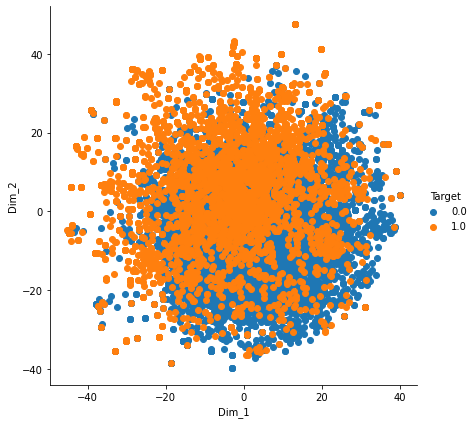

In [ ]:
sns.FacetGrid(tsne_df, hue='Target', size=6).map(plt.scatter, 'Dim_1', 'Dim_2').add_legend()
plt.show()

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf = TfidfVectorizer(max_features=4000, analyzer='word', ngram_range=(2,2), stop_words='english',use_idf=True)
train = tfidf.fit_transform(train['text']).toarray()

In [ ]:
#Dataframe of Bigrams after using Tfidf
matrix2 = pd.DataFrame(train,columns=tfidf.get_feature_names())
matrix2

,aba woman,abandoned aircraft,abbswinston zionist,abc news,abcnews obama,access secret,accident expert,accident indian,accident man,accident property,account hiroshima,accuses nema,act mass,action hostage,action year,activates municipal,active exploit,added video,admits arson,advertised new,advisory effect,advisory issued,affected fatal,affecting sturgis,affiliate marketer,afghan war,afghanistan sharp,africa ap,africa news,afterlife islam,aftershock httptcothyzomvwu,aftershock httptcovampodgyw,aftershock protect,ago today,ahead financing,aid famine,aid kit,aid sick,aim taiwan,air accident,...,year ago,year atomic,year burning,year caused,year census,year fergusons,year fergusonûªs,year later,year old,year went,year worst,yearold boy,yes want,yobe state,york time,young people,youngheroesid lava,yous cable,yous forest,yous national,yous record,youth saved,youtube playlist,youtube video,youûªve home,yr old,yyc abstorm,zionist terrorist,zombie apocalypse,zone coming,û_ blowmandyup,ûextremely offensiveûª,ûpolitics griefûª,ûïhatchet controlû,ûïrichmond coach,ûïwe lose,ûïwhen saw,ûò bbsp,ûò video,ûó story
0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7608,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7609,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7610,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=0)
text_tsne = tsne.fit_transform(matrix2)

tsne_1 = np.vstack((text_tsne.T, train['target'])).T
tsne_df = pd.DataFrame(data=tsne_1, columns=('Dim_1', 'Dim_2', 'Target'))

tsne_df.head()

,Dim_1,Dim_2,Target
0,-3.904036,2.443351,1.0
1,-2.156919,3.217115,1.0
2,4.614384,-1.649968,1.0
3,71.967346,-21.698332,1.0
4,-2.175764,1.909990,1.0


/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


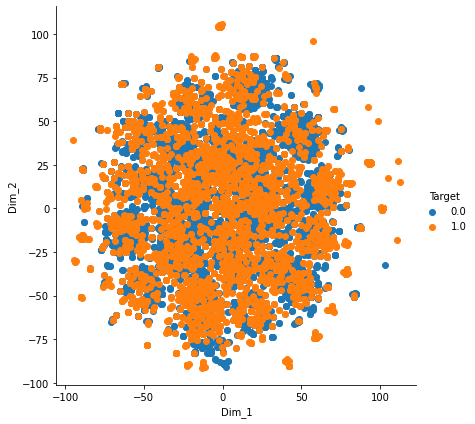

In [ ]:
sns.FacetGrid(tsne_df, hue='Target', size=6).map(plt.scatter, 'Dim_1', 'Dim_2').add_legend()
plt.show()

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf = TfidfVectorizer(max_features=2000, analyzer='word', ngram_range=(3,3), stop_words='english',use_idf=True)
train = tfidf.fit_transform(train['text']).toarray()

In [ ]:
#Dataframe of Trigrams after using Tfidf
matrix3 = pd.DataFrame(train,columns=tfidf.get_feature_names())
matrix3

,aba woman delivers,abandoned aircraft mma,abbswinston zionist terrorist,abcnews obama declares,access secret earner,accident indian express,accident man died,accident property damage,accuses nema stealing,act mass murder,action year fergusons,activated municipal emergency,activates municipal emergency,active exploit bypass,acute flood derail,added video youtube,admits arson scheme,advertised new friend,advisory issued august,affected fatal outbreak,affecting sturgis later,afghanistan sharp rise,africa ap nri,aftershock httptcothyzomvwu djicemoon,aftershock httptcovampodgyw djicemoon,aftershock protect profit,air accident expert,air ambulance helicopter,aircraft debris la,airplane debris reunion,airport swallowed sandstorm,alabama home quarantined,allah describes piling,allows parole california,allows parole school,alp kill rome,ambulance helicopter crash,ambulance sprinter automatic,america plaguing farrakhan,amid crisis famine,...,wrapup yous cable,wreck wreck wreck,wreckage conclusively confirmed,wreckage flight mh,wrecked disney stock,ww read ebay,wwi wwii japanese,wwii japanese army,yazidis blast lack,year ago today,year atomic bomb,year caused structural,year fergusons upheaval,yearold boy charged,yobe state daily,york killed people,young people business,youngheroesid lava blast,yous cable tv,yous forest service,yous helicopter official,yous national park,yous record hurricane,youth explosion past,youth saved life,youtube military veteran,youtube video dannyonpc,youûªve home phone,yr old pkk,zone coming soon,ûextremely offensiveûª community,ûgood samaritansûª shot,ûplot hijack transfer,ûpolitics griefûª israel,ûåêdemolition house waterway,ûïhannaphû soudelor tropical,ûïrichmond coach devastated,ûïwe lose republican,ûïwhen saw coach,ûó story volga
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7608,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=0)
text_tsne = tsne.fit_transform(matrix3)

tsne_1 = np.vstack((text_tsne.T, train['target'])).T
tsne_df = pd.DataFrame(data=tsne_1, columns=('Dim_1', 'Dim_2', 'Target'))

tsne_df.head()

,Dim_1,Dim_2,Target
0,1.917858,3.095768,1.0
1,1.342840,2.948381,1.0
2,1.949779,3.095104,1.0
3,1.082202,2.862902,1.0
4,1.082208,2.862747,1.0


/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


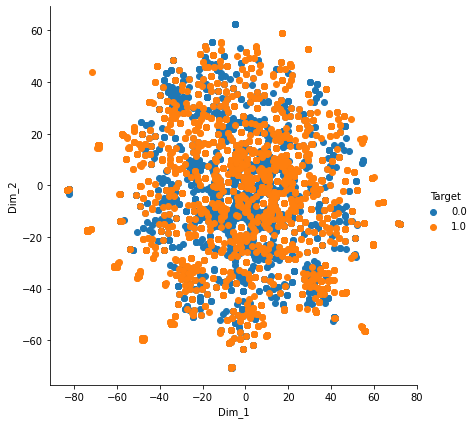

In [ ]:
sns.FacetGrid(tsne_df, hue='Target', size=6).map(plt.scatter, 'Dim_1', 'Dim_2').add_legend()
plt.show()

**PERFORMANCE METRIC**

1. Since Accuracy does not perform well when the data is skewed that's why we won't choose accuracy as our performance metric.
2. Since we need high precision and recall we will use F1-Score as our metric.
3. We will also use the Confusion Matrix for getting the report of our classification.

**BAG OF WORDS**

In [ ]:
#Dataframe of Trigrams after using BOW
from sklearn.feature_extraction.text import CountVectorizer
count_vector = CountVectorizer(binary='True',ngram_range=(1, 1))
train=count_vector.fit_transform(train['text']).toarray()
count_vector.get_feature_names()

['__',
 '__ohhmyjoshh',
 '__scrambledeggs',
 '__srajapakse__',
 '_animaladvocate',
 '_ashj',
 '_asianshawtyy',
 '_bookofdaniel',
 '_charleyisqueen',
 '_chelsdelong',
 '_dangdaddy',
 '_dangerousbeans',
 '_dc',
 '_dmerida',
 '_doofus_',
 '_edvinnn',
 '_explicitpretty',
 '_freemarketeer',
 '_gaabyx',
 '_itsdanie_',
 '_itsmegss_',
 '_itzsteven',
 '_jeesss_',
 '_minimehh',
 '_ohhsehuns',
 '_oliviaann_',
 '_one',
 '_onlyftf',
 '_pokemoncards_',
 '_reddevillife_',
 '_rosewell',
 '_stiiilo',
 '_wildfire__',
 'a__cee',
 'aa',
 'aaaa',
 'aaaaaaallll',
 'aaaaaand',
 'aaarrrgghhh',
 'aace_org',
 'aal',
 'aampb',
 'aampw',
 'aan',
 'aannnnd',
 'aar',
 'aaronthefm',
 'aashiqui',
 'ab',
 'aba',
 'abandon',
 'abandoned',
 'abandonedpics',
 'abandoning',
 'abbandoned',
 'abbott',
 'abbruchsimulator',
 'abbswinston',
 'abbyairshow',
 'abc',
 'abcchicago',
 'abceyewitness',
 'abcnews',
 'abcnorio',
 'abe',
 'aberdeen',
 'aberdeenfanpage',
 'aberdeenfc',
 'aberystwythshrewsbury',
 'abes',
 'abha',
 'abia'

In [ ]:
print(len(count_vector.get_feature_names()))

20257


In [ ]:
text_array1= pd.DataFrame(train,columns=count_vector.get_feature_names())
text_array1

,__,__ohhmyjoshh,__scrambledeggs,__srajapakse__,_animaladvocate,_ashj,_asianshawtyy,_bookofdaniel,_charleyisqueen,_chelsdelong,_dangdaddy,_dangerousbeans,_dc,_dmerida,_doofus_,_edvinnn,_explicitpretty,_freemarketeer,_gaabyx,_itsdanie_,_itsmegss_,_itzsteven,_jeesss_,_minimehh,_ohhsehuns,_oliviaann_,_one,_onlyftf,_pokemoncards_,_reddevillife_,_rosewell,_stiiilo,_wildfire__,a__cee,aa,aaaa,aaaaaaallll,aaaaaand,aaarrrgghhh,aace_org,...,ûthe,ûthem,ûvulnerableûª,ûwe,ûª,ûåêdemolition,ûï,ûïa,ûïafter,ûïairplaneû,ûïall,ûïcat,ûïdetonateû,ûïfor,ûïhannaphû,ûïhatchet,ûïi,ûïlittle,ûïlove,ûïmake,ûïnewsû,ûïnobody,ûïnumbers,ûïparties,ûïplans,ûïrichmond,ûïsippinûª,ûïstretcher,ûïthatûªs,ûïthe,ûïwe,ûïwhen,ûïyou,ûò,ûòthe,ûòåêcnbc,ûó,ûóher,ûókody,ûûif
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7608,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7609,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7610,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7611,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
#Dataframe of Bigrams after using Tfidf
from sklearn.feature_extraction.text import CountVectorizer
count_vector = CountVectorizer(binary='True',ngram_range=(2,2))
train=count_vector.fit_transform(train['text']).toarray()
count_vector.get_feature_names()

['__ month',
 '__ want',
 '__ yazidi_shingal_genocide',
 '__ohhmyjoshh stevenrulles',
 '__scrambledeggs calling',
 '__srajapakse__ thank',
 '_animaladvocate pay',
 '_ashj httptcovbrgjmiy',
 '_asianshawtyy sorry',
 '_bookofdaniel httpstcofkqjyezyg',
 '_charleyisqueen yeah',
 '_chelsdelong kendra_leigh',
 '_dangdaddy siren',
 '_dangerousbeans porridge',
 '_dc cloudy_goldrush',
 '_dmerida tear',
 '_doofus_ diamorfiend',
 '_edvinnn imtariik',
 '_freemarketeer dibang',
 '_gaabyx got',
 '_itsdanie_ noooo',
 '_itsmegss_ think',
 '_itzsteven xdojjjj',
 '_jeesss_ ethereal_',
 '_minimehh cjoyner',
 '_ohhsehuns win',
 '_oliviaann_ looking',
 '_one gwatt',
 '_onlyftf way',
 '_pokemoncards_ icequeenfroslas',
 '_reddevillife_ manutd',
 '_rosewell crashed',
 '_stiiilo still',
 '_wildfire__ bruh',
 'a__cee daem',
 'aa ayyo',
 'aa battery',
 'aa near',
 'aaaa ok',
 'aaaaaaallll iûªm',
 'aaaaaand thunder',
 'aaarrrgghhh httptcoguimbekge',
 'aace_org surprised',
 'aampb pipeliners',
 'aampw pmclose',
 'a

In [ ]:
print(len(count_vector.get_feature_names()))

50043


In [ ]:
text_array2= pd.DataFrame(train,columns=count_vector.get_feature_names())
text_array2

,__ month,__ want,__ yazidi_shingal_genocide,__ohhmyjoshh stevenrulles,__scrambledeggs calling,__srajapakse__ thank,_animaladvocate pay,_ashj httptcovbrgjmiy,_asianshawtyy sorry,_bookofdaniel httpstcofkqjyezyg,_charleyisqueen yeah,_chelsdelong kendra_leigh,_dangdaddy siren,_dangerousbeans porridge,_dc cloudy_goldrush,_dmerida tear,_doofus_ diamorfiend,_edvinnn imtariik,_freemarketeer dibang,_gaabyx got,_itsdanie_ noooo,_itsmegss_ think,_itzsteven xdojjjj,_jeesss_ ethereal_,_minimehh cjoyner,_ohhsehuns win,_oliviaann_ looking,_one gwatt,_onlyftf way,_pokemoncards_ icequeenfroslas,_reddevillife_ manutd,_rosewell crashed,_stiiilo still,_wildfire__ bruh,a__cee daem,aa ayyo,aa battery,aa near,aaaa ok,aaaaaaallll iûªm,...,ûò musician,ûò news,ûò part,ûò public,ûò register,ûò resident,ûò skyåênews,ûò steve,ûò two,ûò usa,ûò video,ûò vladimir,ûò ûïdetonateû,ûòthe united,ûòåêcnbc httptcopnlucerpx,ûó athlete,ûó britain,ûó bulletproof,ûó desolation,ûó eh,ûó head,ûó hiroshimanagasaki,ûó hollyw,ûó httpstcobomjuei,ûó httpstcohukjzwt,ûó httpstcovsqqsvgni,ûó httpstcoyiltbbk,ûó integrates,ûó iûªm,ûó lol,ûó official,ûó oh,ûó organizer,ûó richmond,ûó rt,ûó story,ûó wallybaiter,ûóher upper,ûókody vine,ûûif lost
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7608,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7609,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7610,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7611,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
#Dataframe of Trigrams after using BOW
from sklearn.feature_extraction.text import CountVectorizer
count_vector = CountVectorizer(binary='True',ngram_range=(3,3))
train=count_vector.fit_transform(train['text']).toarray()
count_vector.get_feature_names()

['__ month fr',
 '__ want sleep',
 '__ yazidi_shingal_genocide ezidigenocide',
 '__ohhmyjoshh stevenrulles going',
 '__scrambledeggs calling kia',
 '__srajapakse__ thank missy',
 '_animaladvocate pay photo',
 '_charleyisqueen yeah well',
 '_chelsdelong kendra_leigh crash',
 '_dangdaddy siren telling',
 '_dangerousbeans porridge seriously',
 '_dc cloudy_goldrush hate',
 '_dmerida tear drowned',
 '_doofus_ diamorfiend jokin',
 '_edvinnn imtariik dzafic_haris',
 '_gaabyx got purple',
 '_itsdanie_ noooo almost',
 '_itsmegss_ think well',
 '_itzsteven xdojjjj whopper_jr_',
 '_jeesss_ ethereal_ hello',
 '_minimehh cjoyner must',
 '_ohhsehuns win landslide',
 '_oliviaann_ looking guy',
 '_one gwatt equal',
 '_onlyftf way blew',
 '_pokemoncards_ icequeenfroslas wreck',
 '_reddevillife_ manutd destroyed',
 '_rosewell crashed many',
 '_stiiilo still got',
 '_wildfire__ bruh lady',
 'a__cee daem girl',
 'aa ayyo dei',
 'aa battery swear',
 'aa near bings',
 'aaaa ok lem',
 'aaaaaaallll iûªm even'

In [ ]:
print(len(count_vector.get_feature_names()))

47742


In [ ]:
text_array3= pd.DataFrame(train,columns=count_vector.get_feature_names())
text_array3

,__ month fr,__ want sleep,__ yazidi_shingal_genocide ezidigenocide,__ohhmyjoshh stevenrulles going,__scrambledeggs calling kia,__srajapakse__ thank missy,_animaladvocate pay photo,_charleyisqueen yeah well,_chelsdelong kendra_leigh crash,_dangdaddy siren telling,_dangerousbeans porridge seriously,_dc cloudy_goldrush hate,_dmerida tear drowned,_doofus_ diamorfiend jokin,_edvinnn imtariik dzafic_haris,_gaabyx got purple,_itsdanie_ noooo almost,_itsmegss_ think well,_itzsteven xdojjjj whopper_jr_,_jeesss_ ethereal_ hello,_minimehh cjoyner must,_ohhsehuns win landslide,_oliviaann_ looking guy,_one gwatt equal,_onlyftf way blew,_pokemoncards_ icequeenfroslas wreck,_reddevillife_ manutd destroyed,_rosewell crashed many,_stiiilo still got,_wildfire__ bruh lady,a__cee daem girl,aa ayyo dei,aa battery swear,aa near bings,aaaa ok lem,aaaaaaallll iûªm even,aaaaaand thunder lightning,aace_org surprised still,aampb pipeliners httptcopstbbqav,aampw pmclose help,...,ûò hope christ,ûò malaysian pm,ûò musician collide,ûò news story,ûò part httptcosbfglqjzfs,ûò public ûò,ûò register httptcolhtvkcoiso,ûò resident living,ûò skyåênews httptcogjskurr,ûò steve job,ûò two car,ûò usa liberty,ûò video httptcoeshtylbnl,ûò video httptcouvmyha,ûò video httptcoybemgzl,ûò vladimir putin,ûò ûïdetonateû ft,ûòthe united na,ûó athlete collapsed,ûó britain httpstcoirfcnszv,ûó bulletproof black,ûó desolation row,ûó eh hello,ûó head st,ûó hiroshimanagasaki atomic,ûó hollyw httptcocecvlhw,ûó integrates fat,ûó iûªm thank,ûó lol httptcoumzkcazwd,ûó official think,ûó oh oh,ûó organizer lollapalooza,ûó richmond pol,ûó richmond police,ûó rt news,ûó story volga,ûó wallybaiter httptcogbrnulpfh,ûóher upper armûò,ûókody vine kombatfans,ûûif lost amp
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7608,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7609,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7610,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7611,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


**TFIDF-W2V**

In [ ]:
!pip install gensim==3.8.3
!pip install spacy==2.2.4
!python -m spacy download en_core_web_sm
!pip install matplotlib
!pip install tqdm

     |████████████████████████████████| 24.2 MB 55.0 MB/s 
  Attempting uninstall: gensim
    Found existing installation: gensim 3.6.0
    Uninstalling gensim-3.6.0:
      Successfully uninstalled gensim-3.6.0
     |████████████████████████████████| 12.0 MB 5.1 MB/s 
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_sm')


In [ ]:
from gensim.models.phrases import Phrases, Phraser
from gensim.models import Word2Vec
import pickle
from tqdm import tqdm

In [ ]:
with open('/content/drive/MyDrive/glove_vectors', 'rb') as f:
  model = pickle.load(f)
  glove_words = set(model.keys())

In [ ]:
tfidf_model = TfidfVectorizer(use_idf=True)
tfidf_model.fit(train['text'].values)
dictionary = dict(zip(tfidf_model.get_feature_names(), list(tfidf_model.idf_)))
tfidf_words = set(tfidf_model.get_feature_names())

In [ ]:
train_tfidf_w2v_text = []; 
for sentence in tqdm(df['text']): 
  vector = np.zeros(300) 
  tf_idf_weight =0; 
  for word in sentence.split(): 
    if (word in glove_words) and (word in tfidf_words):
      vec = model[word] 
      tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) 
      tf_idf_weight += tf_idf
  if tf_idf_weight != 0:
    vector /= tf_idf_weight
  train_tfidf_w2v_text.append(vector)

print(len(train_tfidf_w2v_text))
print(len(train_tfidf_w2v_text[0]))

100%|██████████| 7613/7613 [00:00<00:00, 31369.29it/s]

7613
300


In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=0)
text_tsne = tsne.fit_transform(train_tfidf_w2v_text)

mnist_tsne_1 = np.vstack((text_tsne.T, train['target'])).T
tsne_df = pd.DataFrame(data=tsne_1, columns=('Dim_1', 'Dim_2', 'Target'))

tsne_df.head()

,Dim_1,Dim_2,Target
0,1.917858,3.095768,1.0
1,1.342840,2.948381,1.0
2,1.949779,3.095104,1.0
3,1.082202,2.862902,1.0
4,1.082208,2.862747,1.0


/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:337: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


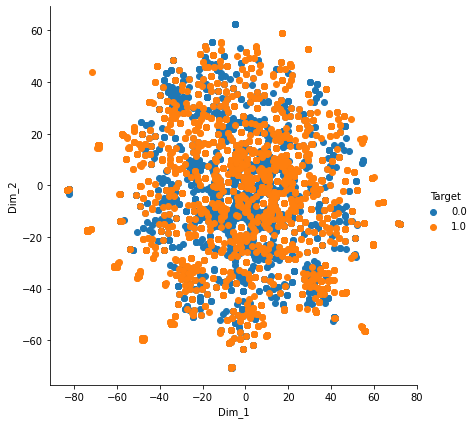

In [ ]:
sns.FacetGrid(tsne_df, hue='Target', size=6).map(plt.scatter, 'Dim_1', 'Dim_2').add_legend()
plt.show()

**MODEL BUILDING**

**MACHINE LEARNING MODELS**

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
y=train['target']

X_train, X_test, y_train, y_test = train_test_split(matrix1, y,stratify=y,test_size=0.25)


**Vectorizer-Tfidf**

KNN

In [ ]:
from sklearn.metrics import accuracy_score,f1_score
from sklearn.neighbors import KNeighborsClassifier
alpha = [x for x in range(1, 15, 2)]
for i in alpha:
  k_cfl=KNeighborsClassifier(n_neighbors=i)
  k_cfl.fit(X_train,y_train)
  prediction=k_cfl.predict(X_test)
  print('The accuracy using K-NN for NN = {} is : {}'.format(i,accuracy_score(y_test,prediction)))
  print('The F1-Score using K-NN for NN = {} is : {}'.format(i,f1_score(y_test,prediction, average='micro')))


The accuracy using K-NN for NN = 1 is : 0.6859243697478992
The F1-Score using K-NN for NN = 1 is : 0.6859243697478992
The accuracy using K-NN for NN = 3 is : 0.6638655462184874
The F1-Score using K-NN for NN = 3 is : 0.6638655462184874
The accuracy using K-NN for NN = 5 is : 0.6696428571428571
The F1-Score using K-NN for NN = 5 is : 0.6696428571428571
The accuracy using K-NN for NN = 7 is : 0.6554621848739496
The F1-Score using K-NN for NN = 7 is : 0.6554621848739496
The accuracy using K-NN for NN = 9 is : 0.6470588235294118
The F1-Score using K-NN for NN = 9 is : 0.6470588235294118


Logistic Regression

In [ ]:
alpha = [10 ** x for x in range(-5, 4)]
from sklearn.linear_models import LogisticRegression
for i in alpha:
  logisticR=LogisticRegression(penalty='l2',C=i,class_weight='balanced')
  logisticR.fit(X_train,y_train)
  prediction=logisticR.predict(X_test)
  print('The accuracy using LR for C = {} is : {}'.format(i,accuracy_score(y_test,prediction)))
  print('The F1-Score using LR for C = {} is : {}'.format(i,f1_score(y_test,prediction, average='micro')))

The accuracy using LR for C = 0.001 is : 0.7904411764705882
The F1-Score using LR for C = 0.001 is : 0.7904411764705882
The accuracy using LR for C = 0.01 is : 0.792016806722689
The F1-Score using LR for C = 0.01 is : 0.792016806722689
The accuracy using LR for C = 0.1 is : 0.7967436974789915
The F1-Score using LR for C = 0.1 is : 0.7967436974789915
The accuracy using LR for C = 1 is : 0.789390756302521
The F1-Score using LR for C = 1 is : 0.789390756302521
The accuracy using LR for C = 10 is : 0.7641806722689075
The F1-Score using LR for C = 10 is : 0.7641806722689074


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


The accuracy using LR for C = 100 is : 0.7599789915966386
The F1-Score using LR for C = 100 is : 0.7599789915966387
The accuracy using LR for C = 1000 is : 0.7463235294117647
The F1-Score using LR for C = 1000 is : 0.7463235294117647


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


Random Forest Classifier

In [ ]:
alpha=[10,50,100,500,1000,2000,3000]
from sklearn.ensemble import RandomForestClassifier
for i in alpha:
  r_cfl=RandomForestClassifier(n_estimators=i,random_state=42,n_jobs=-1)
  r_cfl.fit(X_train,y_train)
  prediction=r_cfl.predict(X_test)
  print('The accuracy using RF for estimators = {} is : {}'.format(i,accuracy_score(y_test,prediction)))
  print('The F1-Score using RF for estimators = {} is : {}'.format(i,f1_score(y_test,prediction, average='micro')))

The accuracy using RF for estimators = 10 is : 0.7510504201680672
The F1-Score using RF for estimators = 10 is : 0.7510504201680672
The accuracy using RF for estimators = 50 is : 0.7710084033613446
The F1-Score using RF for estimators = 50 is : 0.7710084033613446
The accuracy using RF for estimators = 100 is : 0.7836134453781513
The F1-Score using RF for estimators = 100 is : 0.7836134453781513
The accuracy using RF for estimators = 500 is : 0.7836134453781513
The F1-Score using RF for estimators = 500 is : 0.7836134453781513
The accuracy using RF for estimators = 1000 is : 0.7794117647058824
The F1-Score using RF for estimators = 1000 is : 0.7794117647058824
The accuracy using RF for estimators = 2000 is : 0.7794117647058824
The F1-Score using RF for estimators = 2000 is : 0.7794117647058824


XGBoost Classifier

In [ ]:
alpha=[10,50,100,500,1000,2000,3000]
from xgboost import XGBClassifier
for i in alpha:
  x_cfl=XGBClassifier(n_estimators=i,nthread=-1)
  x_cfl.fit(X_train,y_train)
  prediction=x_cfl.predict(X_test)
  print('The accuracy using Xgboost for estimators = {} is : {}'.format(i,accuracy_score(y_test,prediction)))
  print('The F1-Score using Xgboost for estimators = {} is : {}'.format(i,f1_score(y_test,prediction, average='micro')))

The accuracy using Xgboost for estimators = 10 is : 0.6328781512605042
The F1-Score using Xgboost for estimators = 10 is : 0.6328781512605042
The accuracy using Xgboost for estimators = 50 is : 0.6838235294117647
The F1-Score using Xgboost for estimators = 50 is : 0.6838235294117647
The accuracy using Xgboost for estimators = 100 is : 0.7163865546218487
The F1-Score using Xgboost for estimators = 100 is : 0.7163865546218486
The accuracy using Xgboost for estimators = 500 is : 0.7694327731092437
The F1-Score using Xgboost for estimators = 500 is : 0.7694327731092437
The accuracy using Xgboost for estimators = 1000 is : 0.7788865546218487
The F1-Score using Xgboost for estimators = 1000 is : 0.7788865546218487
The accuracy using Xgboost for estimators = 2000 is : 0.7715336134453782
The F1-Score using Xgboost for estimators = 2000 is : 0.7715336134453782


**Vectorizer-Bag Of Words**

In [ ]:
y=train['target']

X_train, X_test, y_train, y_test = train_test_split(text_array1, y,stratify=y,test_size=0.25)

KNN

In [ ]:
from sklearn.metrics import accuracy_score,f1_score
from sklearn.neighbors import KNeighborsClassifier
alpha = [x for x in range(1, 15, 2)]
for i in alpha:
  k_cfl=KNeighborsClassifier(n_neighbors=i)
  k_cfl.fit(X_train,y_train)
  prediction=k_cfl.predict(X_test)
  print('The accuracy using K-NN for NN = {} is : {}'.format(i,accuracy_score(y_test,prediction)))
  print('The F1-Score using K-NN for NN = {} is : {}'.format(i,f1_score(y_test,prediction, average='micro')))

The accuracy using K-NN for NN = 1 is : 0.6917016806722689
The F1-Score using K-NN for NN = 1 is : 0.6917016806722689
The accuracy using K-NN for NN = 3 is : 0.6917016806722689
The F1-Score using K-NN for NN = 3 is : 0.6917016806722689
The accuracy using K-NN for NN = 5 is : 0.6701680672268907
The F1-Score using K-NN for NN = 5 is : 0.6701680672268907
The accuracy using K-NN for NN = 7 is : 0.6502100840336135
The F1-Score using K-NN for NN = 7 is : 0.6502100840336135
The accuracy using K-NN for NN = 9 is : 0.6376050420168067
The F1-Score using K-NN for NN = 9 is : 0.6376050420168067
The accuracy using K-NN for NN = 11 is : 0.634453781512605
The F1-Score using K-NN for NN = 11 is : 0.634453781512605
The accuracy using K-NN for NN = 13 is : 0.6286764705882353
The F1-Score using K-NN for NN = 13 is : 0.6286764705882353


Logistic Regression

In [ ]:
alpha = [10 ** x for x in range(-3, 4)]
from sklearn.linear_model import LogisticRegression
for i in alpha:
  logisticR=LogisticRegression(penalty='l2',C=i,class_weight='balanced')
  logisticR.fit(X_train,y_train)
  prediction=logisticR.predict(X_test)
  print('The accuracy using LR for C = {} is : {}'.format(i,accuracy_score(y_test,prediction)))
  print('The F1-Score using LR for C = {} is : {}'.format(i,f1_score(y_test,prediction, average='micro')))

The accuracy using LR for C = 0.001 is : 0.7673319327731093
The F1-Score using LR for C = 0.001 is : 0.7673319327731093
The accuracy using LR for C = 0.01 is : 0.779936974789916
The F1-Score using LR for C = 0.01 is : 0.779936974789916
The accuracy using LR for C = 0.1 is : 0.7857142857142857
The F1-Score using LR for C = 0.1 is : 0.7857142857142857
The accuracy using LR for C = 1 is : 0.782563025210084
The F1-Score using LR for C = 1 is : 0.782563025210084


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


The accuracy using LR for C = 10 is : 0.7647058823529411
The F1-Score using LR for C = 10 is : 0.7647058823529412


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


The accuracy using LR for C = 100 is : 0.7615546218487395
The F1-Score using LR for C = 100 is : 0.7615546218487395
The accuracy using LR for C = 1000 is : 0.7631302521008403
The F1-Score using LR for C = 1000 is : 0.7631302521008403


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


Random Forest Classifier

In [ ]:
alpha=[50,100,500,1000,2000]
from sklearn.ensemble import RandomForestClassifier
for i in alpha:
  r_cfl=RandomForestClassifier(n_estimators=i,random_state=42,n_jobs=-1)
  r_cfl.fit(X_train,y_train)
  prediction=r_cfl.predict(X_test)
  print('The accuracy using RF for estimators = {} is : {}'.format(i,accuracy_score(y_test,prediction)))
  print('The F1-Score using RF for estimators = {} is : {}'.format(i,f1_score(y_test,prediction, average='micro')))

The accuracy using RF for estimators = 10 is : 0.7552521008403361
The F1-Score using RF for estimators = 10 is : 0.7552521008403361
The accuracy using RF for estimators = 50 is : 0.7710084033613446
The F1-Score using RF for estimators = 50 is : 0.7710084033613446
The accuracy using RF for estimators = 100 is : 0.7694327731092437
The F1-Score using RF for estimators = 100 is : 0.7694327731092437
The accuracy using RF for estimators = 500 is : 0.7762605042016807
The F1-Score using RF for estimators = 500 is : 0.7762605042016806


XGBoost

In [ ]:
alpha=[50,100,500,1000,2000]
from xgboost import XGBClassifier
for i in alpha:
  x_cfl=XGBClassifier(n_estimators=i,nthread=-1)
  x_cfl.fit(X_train,y_train)
  prediction=x_cfl.predict(X_test)
  print('The accuracy using Xgboost for estimators = {} is : {}'.format(i,accuracy_score(y_test,prediction)))
  print('The F1-Score using Xgboost for estimators = {} is : {}'.format(i,f1_score(y_test,prediction, average='micro')))

The accuracy using Xgboost for estimators = 50 is : 0.6869747899159664
The F1-Score using Xgboost for estimators = 50 is : 0.6265265957096686
The accuracy using Xgboost for estimators = 100 is : 0.7179621848739496
The F1-Score using Xgboost for estimators = 100 is : 0.6751797721218591
The accuracy using Xgboost for estimators = 500 is : 0.7673319327731093
The F1-Score using Xgboost for estimators = 500 is : 0.7492722411227981
The accuracy using Xgboost for estimators = 1000 is : 0.7720588235294118
The F1-Score using Xgboost for estimators = 1000 is : 0.756726170919578
The accuracy using Xgboost for estimators = 2000 is : 0.7757352941176471
The F1-Score using Xgboost for estimators = 2000 is : 0.763858645375233


**SUMMARY OF ML MODELS**

In [ ]:
from prettytable import PrettyTable
tb = PrettyTable()
tb.field_names= (" Vectorizer ", " Model ", " Best Hyperparameter "," Accuracy ","F1-Score")
tb.add_row([" Tfidf", "KNN" , "K=1" , 68.59 , 68.59])
tb.add_row([" Tfidf", "Logistic Regression" , "C=0.1" , 79.67 ,79.67])
tb.add_row([" Tfidf", "Random Forest" , "Estimators=100" , 78.36 ,78.36])
tb.add_row([" Tfidf", "XGBoost" , "Estimators=1000" , 77.88 ,77.88])
tb.add_row([" BOW", "KNN" , "K=3" , 69.17 , 69.17 ])
tb.add_row([" BOW", "Logistic Regression" , "C=0.1" , 78.57 ,78.57])
tb.add_row([" BOW", "Random Forest" , "Estimators=500" , 77.62 , 77.62 ])
tb.add_row([" BOW", "XGBoost" , "Estimators=2000" , 77.57 , 76.38 ])

In [ ]:
print(tb.get_string(titles = "Observations"))

+--------------+---------------------+-----------------------+------------+----------+
|  Vectorizer  |        Model        |  Best Hyperparameter  |  Accuracy  | F1-Score |
+--------------+---------------------+-----------------------+------------+----------+
|     Tfidf    |         KNN         |          K=1          |   68.59    |  68.59   |
|     Tfidf    | Logistic Regression |         C=0.1         |   79.67    |  79.67   |
|     Tfidf    |    Random Forest    |     Estimators=100    |   78.36    |  78.36   |
|     Tfidf    |       XGBoost       |    Estimators=1000    |   77.88    |  77.88   |
|      BOW     |         KNN         |          K=3          |   69.17    |  69.17   |
|      BOW     | Logistic Regression |         C=0.1         |   78.57    |  78.57   |
|      BOW     |    Random Forest    |     Estimators=500    |   77.62    |  77.62   |
|      BOW     |       XGBoost       |    Estimators=2000    |   77.57    |  76.38   |
+--------------+---------------------+-----

**LSTM**

In [ ]:
train=pd.read_csv('/content/train.csv')
train.head()

,id,keyword,location,text,target
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake M...,1
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada,1
2,5,NaN,NaN,All residents asked to 'shelter in place' are ...,1
3,6,NaN,NaN,"13,000 people receive #wildfires evacuation or...",1
4,7,NaN,NaN,Just got sent this photo from Ruby #Alaska as ...,1


In [ ]:
y=train['target']
X=train
X.head()

,id,keyword,location,text,target
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake M...,1
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada,1
2,5,NaN,NaN,All residents asked to 'shelter in place' are ...,1
3,6,NaN,NaN,"13,000 people receive #wildfires evacuation or...",1
4,7,NaN,NaN,Just got sent this photo from Ruby #Alaska as ...,1


In [ ]:
X.drop(['target'],axis=1,inplace=True)
X.head()

,id,keyword,location,text
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake M...
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada
2,5,NaN,NaN,All residents asked to 'shelter in place' are ...
3,6,NaN,NaN,"13,000 people receive #wildfires evacuation or..."
4,7,NaN,NaN,Just got sent this photo from Ruby #Alaska as ...


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y,stratify=y,test_size=0.25)

In [ ]:
from keras.preprocessing.text import Tokenizer
tokenizer = Tokenizer(num_words= 100000 )
tokenizer.fit_on_texts(X_train["text"])

X_train['text_tok']  = tokenizer.texts_to_sequences(X_train['text'].values)
X_test['text_tok']  = tokenizer.texts_to_sequences(X_test['text'].values)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
X_train.head()

,id,keyword,location,text,text_tok
3634,5183,fatalities,jersey,mortal kombat fatalities are so gross but inte...,"[2007, 2008, 366, 23, 35, 5788, 33, 1031]"
574,832,bioterror,NC,FedEx no longer will transport bioterror germs...,"[385, 40, 541, 41, 609, 418, 855, 3, 1, 2, 578..."
6986,10018,twister,NaN,Twister was fun https://t.co/qCT6fb8wOn,"[497, 26, 728, 22, 1, 2, 5790]"
5192,7413,obliterated,NaN,Drunk Meals 101: What To Cook When You're Tota...,"[1307, 2891, 2009, 60, 7, 1434, 45, 173, 900, ..."
6657,9540,terrorist,NaN,Three Israeli soldiers wounded in West Bank te...,"[542, 691, 1755, 386, 6, 729, 2353, 291, 124, ..."


In [ ]:
X_test.head()

,id,keyword,location,text,text_tok
5101,7277,nuclear%20disaster,#goingdownthetoilet Illinois,CLOSING THEIR EYES TO DISASTER! State Departm...,"[15996, 141, 842, 7, 76, 276, 1545, 8, 991, 47..."
1052,1521,body%20bags,NaN,women messenger bags clutch bag handbag cross ...,"[495, 3681, 411, 2450, 427, 1257, 226, 89, 708..."
7047,10098,typhoon,"anzio,italy",Map: Typhoon Soudelor's predicted path as it a...,"[1503, 258, 11604, 4686, 3403, 31, 17, 2495, 1..."
4665,6631,inundated,"Paducah, KY",@Bilsko and suddenly I'm inundated with resear...,"[9, 4913, 46, 458, 16, 992]"
5526,7882,quarantined,Mongolia,#hot Reddit's new content policy goes into ef...,"[212, 940, 55, 237, 620, 631, 70, 707, 137, 47..."


In [ ]:
from keras.preprocessing import sequence
max_tweet_length = 250
X_train_pad = sequence.pad_sequences(X_train['text_tok'].values, maxlen=max_tweet_length , padding='post' )
X_test_pad  = sequence.pad_sequences(X_test['text_tok'].values, maxlen=max_tweet_length , padding='post')

In [ ]:
import tensorflow as tf
import pickle
with open('/content/drive/MyDrive/glove_vectors', 'rb') as f:
    glove = pickle.load(f)
    glove_words =  set(glove.keys())

In [ ]:
from numpy import zeros
max_vocabulary = len(tokenizer.word_index)
embedding_matrix = zeros((max_vocabulary+1, 300))
for word, i in tokenizer.word_index.items():
  if word in glove_words:
    embedding_vector = glove[word]
    embedding_matrix[i] = embedding_vector

In [ ]:
from keras.utils import np_utils
X_train = X_train_pad
X_test = X_test_pad
Y_train = y_train
Y_test = y_test

In [ ]:
from sklearn.metrics import f1_score
class F1score(tf.keras.callbacks.Callback):
  def __init__(self,x_test,y_test):
    super(F1score,self).__init__()
    self.x_test=x_test
    self.y_test=y_test
    self.history={'auc': [],'F1_score':[]}
  def on_epoch_end(self, epoch, logs={}):
    y_pred=self.model.predict(self.x_test)
    pred=[1 if x>0.5 else 0 for x in y_pred]
    f1 = f1_score(y_test,pred)
    logs['f1_score']=f1
    print("The F1 score for this epoch is: ",f1)

In [ ]:
class AchieveTarget(tf.keras.callbacks.Callback):
  def __init__(self, target):
    super(AchieveTarget, self).__init__()
    self.target = target
  def on_epoch_end(self, epoch, logs={}):
    acc = logs['f1_score']
    if (acc >= self.target):
      self.model.stop_training = True

In [ ]:
import datetime
log_dir="logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_cb= tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1,write_graph=True,write_grads=True)

target = AchieveTarget(0.80)
metrics=F1score(x_test=X_test,y_test=Y_test)
callbacks = [metrics,target,tensorboard_cb,]

In [ ]:
from tensorflow.keras.layers import Dense, Input , Dropout,Flatten,concatenate,LSTM,Conv1D,BatchNormalization,Bidirectional
from tensorflow.keras.regularizers import l2
from keras.layers.embeddings import Embedding
from tensorflow.keras.models import Model,load_model


tweet = Input(shape=(250,), name='tweet_input')

X = Embedding(output_dim=300, input_dim=max_vocabulary+1, input_length=250 , weights=[embedding_matrix],trainable=False)(tweet)
lstm_tweet = Bidirectional(LSTM(128))(X)

model = Dropout(0.2)(lstm_tweet)

model = Flatten()(model)

model = Dense(64,activation="relu",kernel_initializer="glorot_normal" ,kernel_regularizer=l2(0.001))(model)

output = Dense(1, activation='sigmoid', name='output')(model)

model_1 = Model(inputs=[tweet ],outputs=[output])

print(model_1.summary())

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
tweet_input (InputLayer)     [(None, 250)]             0         
_________________________________________________________________
embedding (Embedding)        (None, 250, 300)          5564100   
_________________________________________________________________
bidirectional (Bidirectional (None, 256)               439296    
_________________________________________________________________
dropout (Dropout)            (None, 256)               0         
_________________________________________________________________
flatten (Flatten)            (None, 256)               0         
_________________________________________________________________
dense (Dense)                (None, 64)                16448     
_________________________________________________________________
output (Dense)               (None, 1)                 65    

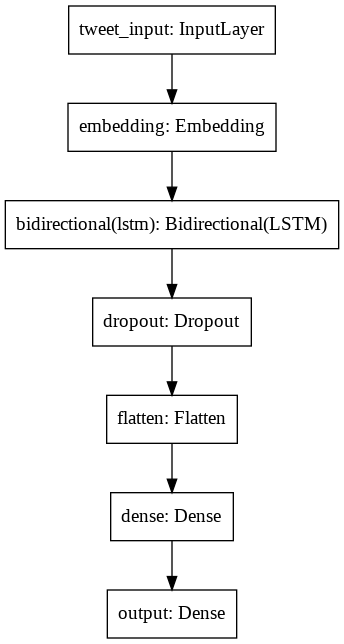

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model_1)

In [ ]:
model_1.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
history = model_1.fit(X_train, Y_train, batch_size=256, callbacks=callbacks, epochs=10, verbose=1, validation_data=(X_test, Y_test))

Epoch 1/10
23/23 [==============================] - 105s 4s/step - loss: 0.6835 - accuracy: 0.6858 - val_loss: 0.5651 - val_accuracy: 0.7631
The F1 score for this epoch is:  0.7357937902753369
Epoch 2/10
23/23 [==============================] - 86s 4s/step - loss: 0.5446 - accuracy: 0.7830 - val_loss: 0.5340 - val_accuracy: 0.7873
The F1 score for this epoch is:  0.695717505634861
Epoch 3/10
23/23 [==============================] - 87s 4s/step - loss: 0.4876 - accuracy: 0.8096 - val_loss: 0.4708 - val_accuracy: 0.8072
The F1 score for this epoch is:  0.7609120521172639
Epoch 4/10
23/23 [==============================] - 99s 4s/step - loss: 0.4558 - accuracy: 0.8187 - val_loss: 0.4629 - val_accuracy: 0.8099
The F1 score for this epoch is:  0.7468531468531469
Epoch 5/10
23/23 [==============================] - 88s 4s/step - loss: 0.4284 - accuracy: 0.8322 - val_loss: 0.4535 - val_accuracy: 0.8067
The F1 score for this epoch is:  0.7597911227154047
Epoch 6/10
23/23 [======================

In [ ]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

In [ ]:
from prettytable import PrettyTable
tb = PrettyTable()
tb.field_names= (" Vectorizer ", " Model "," Accuracy ","F1-Score")
tb.add_row([" W2V", "LSTM"  , 80.93 , 76.53])

In [ ]:
print(tb.get_string(titles = "Observations"))

+--------------+---------+------------+----------+
|  Vectorizer  |  Model  |  Accuracy  | F1-Score |
+--------------+---------+------------+----------+
|      W2V     |   LSTM  |   80.93    |  76.53   |
+--------------+---------+------------+----------+


**BERT**

In [ ]:
def bert_encode(texts, tokenizer, max_len=512):
    all_tokens = []
    all_masks = []
    all_segments = []
    
    for text in texts:
        text = tokenizer.tokenize(text)
            
        text = text[:max_len-2]
        input_sequence = ["[CLS]"] + text + ["[SEP]"]
        pad_len = max_len - len(input_sequence)
        
        tokens = tokenizer.convert_tokens_to_ids(input_sequence)
        tokens += [0] * pad_len
        pad_masks = [1] * len(input_sequence) + [0] * pad_len
        segment_ids = [0] * max_len
        
        all_tokens.append(tokens)
        all_masks.append(pad_masks)
        all_segments.append(segment_ids)
    
    return np.array(all_tokens), np.array(all_masks), np.array(all_segments)

In [ ]:
import tensorflow_hub as hub
module_url = "https://tfhub.dev/tensorflow/bert_en_uncased_L-24_H-1024_A-16/1"
bert_layer = hub.KerasLayer(module_url, trainable=True)

In [ ]:
!wget --quiet https://raw.githubusercontent.com/tensorflow/models/master/official/nlp/bert/tokenization.py
!pip install bert-for-tf2
import numpy as np
import tensorflow_hub as hub
from bert import bert_tokenization


vocab_file = bert_layer.resolved_object.vocab_file.asset_path.numpy()
do_lower_case = bert_layer.resolved_object.do_lower_case.numpy()
tokenizer = bert_tokenization.FullTokenizer(vocab_file, do_lower_case)

     |████████████████████████████████| 41 kB 125 kB/s 
  Created wheel for bert-for-tf2: filename=bert_for_tf2-0.14.9-py3-none-any.whl size=30534 sha256=3c8fced292397242fb7329ee3d20195e7ff2acff8dd1a7def6f4b58d5a042704
  Stored in directory: /root/.cache/pip/wheels/47/b6/e5/8c76ec779f54bc5c2f1b57d2200bb9c77616da83873e8acb53
  Created wheel for params-flow: filename=params_flow-0.8.2-py3-none-any.whl size=19473 sha256=0f4773d12835a9c50b836fcd970f91a6970b1ac3b3ca4ea34d96ad7e323e43f3
  Stored in directory: /root/.cache/pip/wheels/0e/fc/d2/a44fff33af0f233d7def6e7de413006d57c10e10ad736fe8f5
  Created wheel for py-params: filename=py_params-0.10.2-py3-none-any.whl size=7912 sha256=727fa82a2b1677f48b725d3a4bea8cc9de33d4a06984d5a4d1bfa75873dbe1a7
  Stored in directory: /root/.cache/pip/wheels/e1/11/67/33cc51bbee127cb8fb2ba549cd29109b2f22da43ddf9969716
Successfully built bert-for-tf2 params-flow py-params


In [ ]:
train=pd.read_csv('/content/train.csv')
test=pd.read_csv('/content/test.csv')

In [ ]:
train_input = bert_encode(train.text.values, tokenizer, max_len=50)
test_input = bert_encode(test.text.values, tokenizer, max_len=50)
train_labels = train.target.values

In [ ]:
max_seq_length=50

In [ ]:
def build_model(bert_layer,Dropout_num, max_len=36):
    input_word_ids = tf.keras.layers.Input(shape=(max_len,), dtype=tf.int32, name="input_word_ids")
    input_mask = tf.keras.layers.Input(shape=(max_len,), dtype=tf.int32, name="input_mask")
    segment_ids = tf.keras.layers.Input(shape=(max_len,), dtype=tf.int32, name="segment_ids")

    _, sequence_output = bert_layer([input_word_ids, input_mask, segment_ids])
    clf_output = sequence_output[:, 0, :]
    
    x = tf.keras.layers. Dropout(Dropout_num)(clf_output)
    out4 = tf.keras.layers. Dense(1, activation='sigmoid')(x)
    
    model = tf.keras.models.Model(inputs=[input_word_ids, input_mask, segment_ids], outputs=out4)
#   model.compile(tf.keras.optimizers.Adam(lr=6e-6), loss='binary_crossentropy', metrics=['accuracy'])
    model.compile(tf.keras.optimizers.SGD(learning_rate=0.0001, momentum=0.8), loss='binary_crossentropy', metrics=['accuracy'])
    return model

In [ ]:
import tensorflow as tf
model_BERT = build_model(bert_layer,0, max_len=50)

In [ ]:
import datetime
log_dir="logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_cb2= tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1,write_graph=True,write_grads=True)

def scheduler(epoch):
    return 0.0001 * tf.math.exp(0.1 * (- epoch))

lr = tf.keras.callbacks.LearningRateScheduler(scheduler,verbose=1)

In [ ]:
checkpoint = tf.keras.callbacks.ModelCheckpoint('model_BERT.h5', monitor='val_loss', save_best_only=True,verbose=1)

train_history = model_BERT.fit(
    train_input, train_labels,
    validation_split = 0.25,
    epochs = 10, 
    callbacks=[checkpoint,lr,tensorboard_cb2],
    batch_size = 16,
    verbose=1,
)

Epoch 1/10

Epoch 00001: LearningRateScheduler setting learning rate to tf.Tensor(1e-04, shape=(), dtype=float32).
357/357 [==============================] - 500s 1s/step - loss: 0.5276 - accuracy: 0.7558 - val_loss: 0.4407 - val_accuracy: 0.8136

Epoch 00001: val_loss improved from inf to 0.44067, saving model to model_BERT.h5
Epoch 2/10

Epoch 00002: LearningRateScheduler setting learning rate to tf.Tensor(9.0483736e-05, shape=(), dtype=float32).
357/357 [==============================] - 455s 1s/step - loss: 0.4199 - accuracy: 0.8177 - val_loss: 0.4099 - val_accuracy: 0.8262

Epoch 00002: val_loss improved from 0.44067 to 0.40990, saving model to model_BERT.h5
Epoch 3/10

Epoch 00003: LearningRateScheduler setting learning rate to tf.Tensor(8.187308e-05, shape=(), dtype=float32).
357/357 [==============================] - 415s 1s/step - loss: 0.3823 - accuracy: 0.8389 - val_loss: 0.3872 - val_accuracy: 0.8372

Epoch 00003: val_loss improved from 0.40990 to 0.38722, saving model to m

In [ ]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
model_BERT.load_weights('model_BERT.h5')
test_prediction_BERT = model_BERT.predict(test_input)
test_prediction_BERT_int = test_prediction_BERT.round().astype('int')

In [ ]:
submission_bert= pd.DataFrame()
submission_bert['id'] = test['id']
submission_bert['target'] = test_prediction_BERT_int # our model predictions on the test dataset
submission_bert.head()

,id,target
0,0,1
1,2,1
2,3,1
3,9,1
4,11,1


In [ ]:
submission_bert.to_csv('/content/drive/MyDrive/Colab Notebooks/submission_bert_new.csv', index=False)
print('Submission CSV is ready!')

Submission CSV is ready!


In [ ]:
model_BERT.save('/content/drive/MyDrive/Colab Notebooks/BERT_disaster.h5')

In [ ]:
path='/content/drive/MyDrive/Colab Notebooks/BERT_disaster.h5'
model=tf.keras.models.load_model((path),custom_objects={'KerasLayer':hub.KerasLayer})

In [ ]:
predictions=model.predict(test_input)
predictions
predictions = predictions.round().astype('int')
predictions

array([[1],
       [1],
       [1],
       ...,
       [1],
       [1],
       [1]])

**DEFINING FUNCTIONS**

In [ ]:
train=pd.read_csv('/content/train.csv')
test=pd.read_csv('/content/test.csv')

In [ ]:
train.head()

,id,keyword,location,text,target
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake M...,1
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada,1
2,5,NaN,NaN,All residents asked to 'shelter in place' are ...,1
3,6,NaN,NaN,"13,000 people receive #wildfires evacuation or...",1
4,7,NaN,NaN,Just got sent this photo from Ruby #Alaska as ...,1


In [ ]:
test.head()

,id,keyword,location,text
0,0,NaN,NaN,Just happened a terrible car crash
1,2,NaN,NaN,"Heard about #earthquake is different cities, s..."
2,3,NaN,NaN,"there is a forest fire at spot pond, geese are..."
3,9,NaN,NaN,Apocalypse lighting. #Spokane #wildfires
4,11,NaN,NaN,Typhoon Soudelor kills 28 in China and Taiwan


**PIPELINE 1**

In [ ]:
def Pipeline(K, max_sequence_len, bert_encode):
  if isinstance(K, pd.DataFrame):
    j=K['text']
    y=list(j)
    K.drop(['id','keyword','location'],axis=1)
    f=text_Preprocessing(y)
    K['text']=f
    K['text']= K['text'].apply(lambda h: remove_emoji(h))
    vectors = bert_encode(K.text.values, tokenizer, max_len=50)
    path='/content/drive/MyDrive/Colab Notebooks/BERT_disaster.h5'
    classifier=tf.keras.models.load_model((path),custom_objects={'KerasLayer':hub.KerasLayer})
    prediction=classifier.predict(vectors)
    prediction = prediction.round().astype('int')
    pred=prediction.flatten()
    return pred
  else:
    t=K[3]
    p=text_Preprocessing([t])
    f=p[0]
    n=remove_emoji(f)
    vectors = bert_encode([n], tokenizer, max_len=50)
    path='/content/drive/MyDrive/Colab Notebooks/BERT_disaster.h5'
    classifier=tf.keras.models.load_model((path),custom_objects={'KerasLayer':hub.KerasLayer})
    prediction=classifier.predict(vectors)
    prediction = prediction.round().astype('int')
    pred=prediction.flatten()
    return pred

In [ ]:
def classify(l):
  global max_seq_length
  global text_Preprocessing
  global remove_emoji
  global bert_encode
  return Pipeline(l, max_seq_length, bert_encode)

**FUNCTION 1**

In [ ]:
import tensorflow as tf
def Predict(l):
 k=classify(l)
 return k


In [ ]:
pred=Predict(test.iloc[0:5])
print("The predictions are : {}".format(pred))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


The predictions are : [1 1 1 1 1]


In [ ]:
from sklearn.metrics import accuracy_score,f1_score

In [ ]:
y=train['target']
y

0       1
1       1
2       1
3       1
4       1
       ..
7608    1
7609    1
7610    1
7611    1
7612    1
Name: target, Length: 7613, dtype: int64

**PIPELINE 2**

In [ ]:
def Pipeline(K, y, max_sequence_len, bert_encode):
  if isinstance(K, pd.DataFrame):
    j=K['text']
    q=list(j)
    K.drop(['id','keyword','location'],axis=1)
    f=text_Preprocessing(q)
    K['text']=f
    K['text']= K['text'].apply(lambda h: remove_emoji(h))
    vectors = bert_encode(K.text.values, tokenizer, max_len=50)
    path='/content/drive/MyDrive/Colab Notebooks/BERT_disaster.h5'
    classifier=tf.keras.models.load_model((path),custom_objects={'KerasLayer':hub.KerasLayer})
    prediction=classifier.predict(vectors)
    prediction = prediction.round().astype('int')
    pre=pd.Series(prediction.flatten())
    accuracy = accuracy_score(y,pre)
    F1= f1_score(y,pre)
    return accuracy, F1
  else:
    t=K[3]
    p=text_Preprocessing([t])
    f=p[0]
    n=remove_emoji(f)
    vectors = bert_encode([n], tokenizer, max_len=50)
    path='/content/drive/MyDrive/Colab Notebooks/BERT_disaster.h5'
    classifier=tf.keras.models.load_model((path),custom_objects={'KerasLayer':hub.KerasLayer})
    prediction=classifier.predict(vectors)
    prediction = prediction.round().astype('int')
    accuracy = accuracy_score(pd.Series(y),pd.Series(prediction[0][0]))
    F1= f1_score(pd.Series(y),pd.Series(prediction[0][0]))
    return accuracy,F1

In [ ]:
def classify(x,y):
  global max_seq_length
  global text_Preprocessing
  global remove_emoji
  global bert_encode
  return Pipeline(x,y, max_seq_length, bert_encode)

**FUNCTION 2**

In [ ]:
def Predict2(x,y):
 k=classify(x,y)
 return k

In [ ]:
acc,F1=Predict2(train.iloc[0:10],y[0:10])
print("The accuracy is : {}".format(acc))
print("The F1_Score is : {}".format(F1))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


The accuracy is : 0.8
The F1_Score is : 0.888888888888889


**CONCLUSION**

1. Out of all the ML models Random Forest and Logistic regression performed pretty well and had a good F1 Score and Accuracy.
2. Using Bidirectional LSTM we got improvement in our accuracy and F1 Score compared to that of ML models.
3. BERT gave the best performance with a high Accuracy and F1 Score and we achieved a Kaggle Score of 0.83236 using it.

In [ ]:
!pip install ipynbcompress

  Created wheel for hurry.filesize: filename=hurry.filesize-0.9-py3-none-any.whl size=4133 sha256=19b875aee4069644f98767c5db7b534dad6b250141e4677cce3586c3a7a38472
  Stored in directory: /root/.cache/pip/wheels/2c/99/7f/8c88c372b4bd642a731232e63cb89467554f6cea7708574e49
Successfully built hurry.filesize


In [ ]:
!

In [ ]:
 import os
 from ipynbcompress import compress
 filename = '/content/drive/MyDrive/Final_Case_Study_BEST.ipynb'
 out = '/content/drive/MyDrive/Final_Case_Study_BERT.ipynb'
 compress(filename, output_filename=out, img_width=800, img_format='png')